# 03_Networks
##### Authors: Diego Senso González, Luis Vaciero
##### 15 january 2021
##### Module: Machine Learning - Master's Degree in Data Science for Finance

## Objective
The purpose of this document is to visualize the data available through networks.

## Libraries
Firstly, we import the requested libraries.

In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import sys
!{sys.executable} -m pip install networkx
%matplotlib inline
from IPython.display import HTML
import math
import json
import numpy as np
import pandas as pd
import networkx as nx
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
%matplotlib inline
from pylab import *

## Loading the data

In [2]:
bicimad = pd.read_csv('../data/bicimad.csv', delimiter = ',')
streets = pd.read_csv('../data/streets.csv', delimiter = ',')
neighbourhoods = pd.read_csv('../data/neighbourhoods.csv', delimiter = ',')
districts = pd.read_csv('../data/districts.csv', delimiter = ',')

We remove the first column of each imported dataset, which contains no data.

In [3]:
bicimad.drop(['Unnamed: 0'], axis = 'columns', inplace = True)
streets.drop(['Unnamed: 0'], axis = 'columns', inplace = True)
neighbourhoods.drop(['Unnamed: 0'], axis = 'columns', inplace = True)
districts.drop(['Unnamed: 0'], axis = 'columns', inplace = True)

## Initial view

To begin, we visualize a simple network, selecting the arrival and departure points of the Bicimad dataset (which contains all the trips made).

In [4]:
edges = bicimad[['origin', 'destination']].values
edges

array([['DOCTOR ESQUERDO, CALLE, DEL', 'JUAN DE URBIETA, CALLE, DE'],
       ['DOCTOR ESQUERDO, CALLE, DEL', 'JUAN DE URBIETA, CALLE, DE'],
       ['DOCTOR ESQUERDO, CALLE, DEL', 'JUAN DE URBIETA, CALLE, DE'],
       ...,
       ['ALCALA, CALLE, DE', 'SERRANO, CALLE, DE'],
       ['ALCALA, CALLE, DE', 'SERRANO, CALLE, DE'],
       ['ALCALA, CALLE, DE', 'SERRANO, CALLE, DE']], dtype=object)

In [5]:
g = nx.from_edgelist(edges)

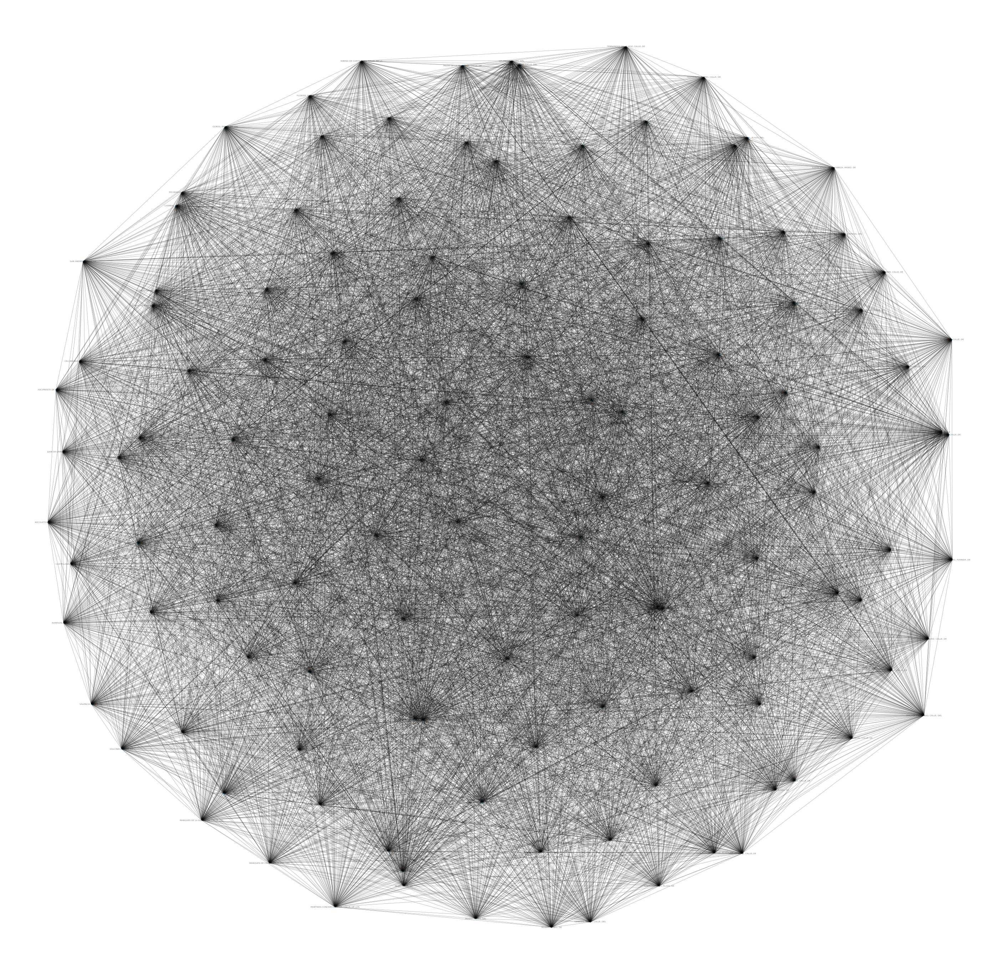

In [6]:
fig, ax = plt.subplots(1, 1, figsize=(50, 50))
nx.draw_networkx(g, ax=ax, node_size=5,
                 font_size=6, alpha=.5,
                 width=.5)
ax.set_axis_off()

Clearly the result is not very explanatory. There are many points of origin and arrival, and many journeys. One can intuit areas where more lines accumulate, which could indicate more transit between those points. However, this is only a first approximation. 

## Street Networks

First of all, we visualize all the connections between streets of the bicycle routes. Given the high number of streets and trips, the network is not very explanatory. Each blue dot represents a street, and the lines that overlap each other are the trips made.

In [7]:
DG=nx.DiGraph()
for row in streets.iterrows():
    DG.add_edge(row[1]["origin"],
                row[1]["destination"],
                number_of_trips = row[1]["number_of_trips"])

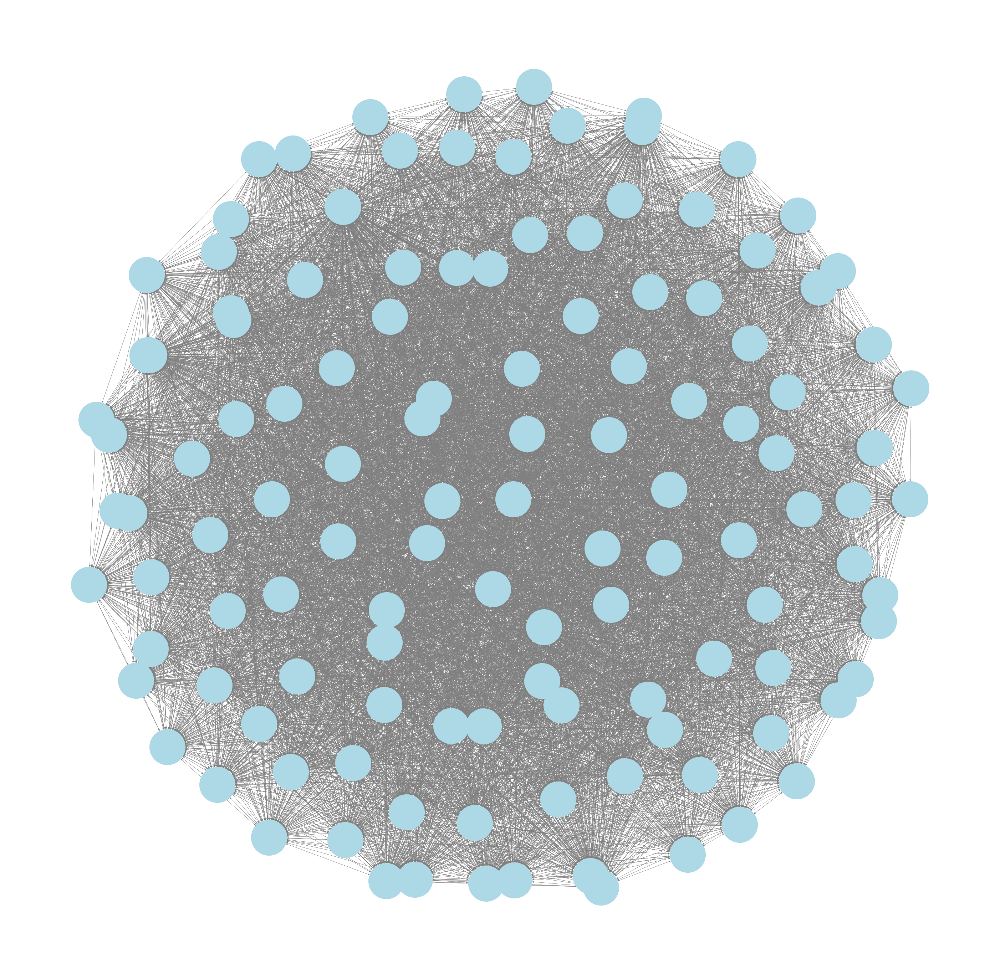

In [8]:
fig, ax = plt.subplots(1, 1, figsize=(50, 50))
nx.draw_spring(DG,
                 node_color="lightblue",
                 edge_color="gray",
                 width=0.5, 
                 with_labels = False, 
                 node_size=10000,
)
ax.set_axis_off()

## Neighbourhood Networks

We went on to observe the journeys by neighborhood. In this graph we can already see more clearly the lines that connect the points. You can also see that each neighborhood has connections with a large number of different neighborhoods, in addition to itself.

In [9]:
DG=nx.DiGraph()
for row in neighbourhoods.iterrows():
    DG.add_edge(row[1]["neighbourhood_origin"],
                row[1]["neighbourhood_destination"],
                number_of_trips = row[1]["number_of_trips"])

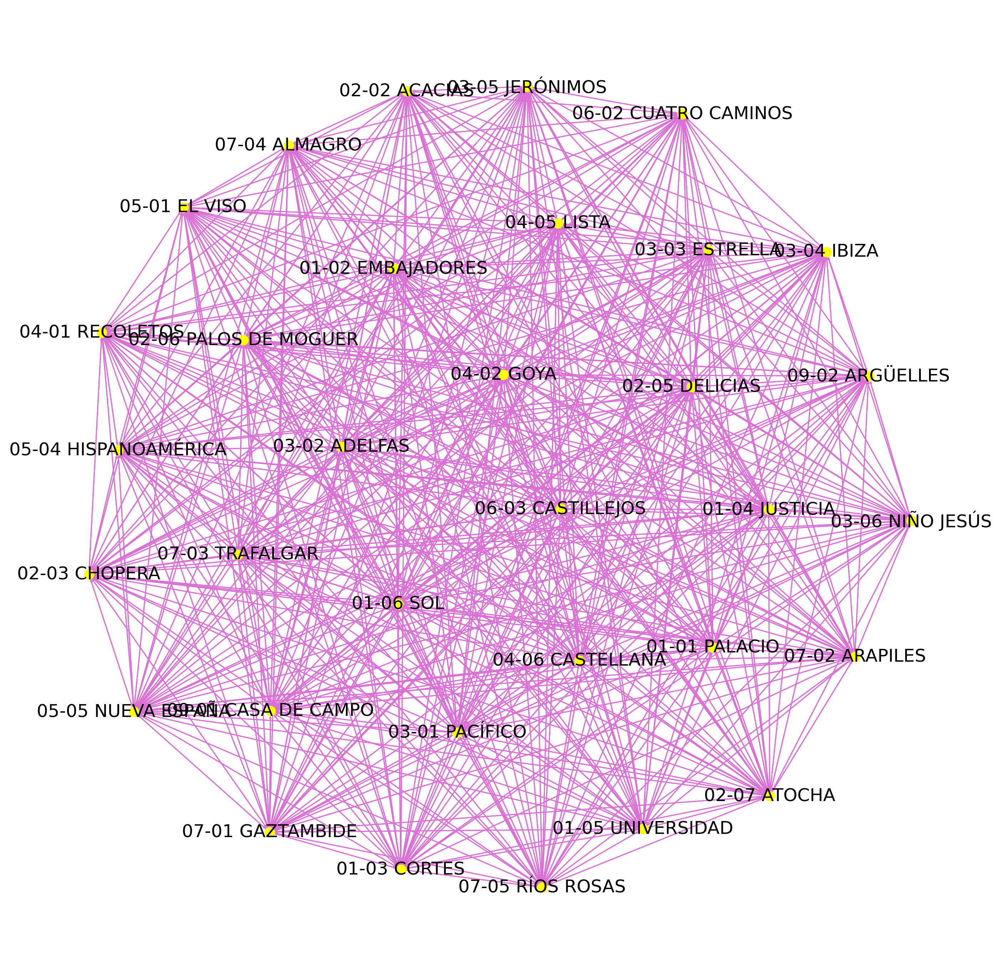

In [10]:
fig, ax = plt.subplots(1, 1, figsize=(50, 50))
nx.draw_spring(DG,
                 node_color="yellow",
                 edge_color="orchid",
                 font_size=50,
                     width=3, with_labels = True, node_size=800,
)
ax.set_axis_off()

Selecting only the neighborhoods of origin, we can proceed to make another type of visualization with networks. In this case, from each node multiple edges come out to other points in concentrated groups. Each node separated from the rest is an origin of trips, while the nodes that are grouped are each of the destinations. This is another way of visualizing the network, focusing the display in this case on the trip origin points.

In [11]:
cluster = nx.from_pandas_edgelist(neighbourhoods,source='neighbourhood_origin', target = "number_of_trips")

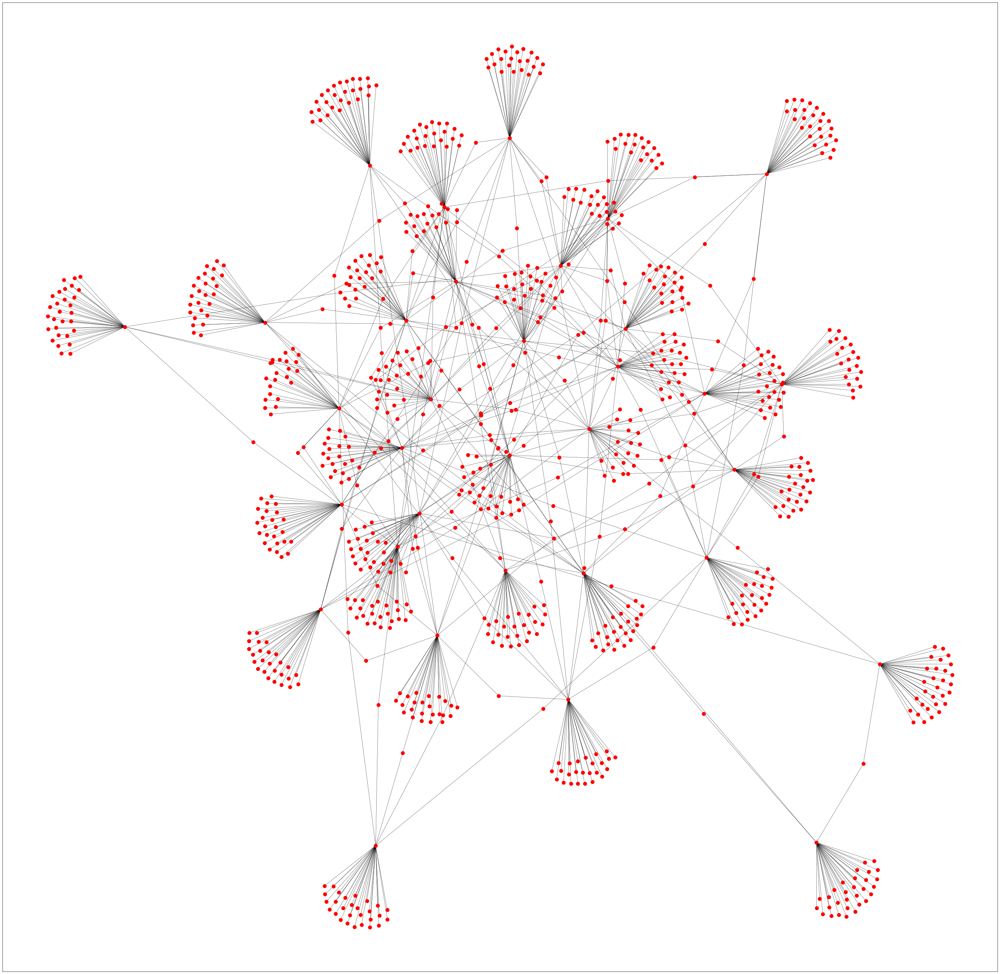

In [12]:
plt.figure(figsize=(50, 50))
pos=nx.spring_layout(cluster)
nx.draw_networkx(cluster,
                 pos = None,
                 with_labels = False,
                 node_size= 100, 
                 node_color='red',
                 width=0.5,
                 font_size= 20)
plt.show()

## District Networks

Now we move on to visualize by districts. This will be the clearest visualization, since the number of districts in the city of Madrid is low compared to the number of different streets and neighborhoods. You can start to see that it is a directed graph, since the edges that connect the points have directions. These edges are usually bidirectional, since there are bicycle routes in both directions.

In [13]:
DG=nx.DiGraph()
for row in districts.iterrows():
    DG.add_edge(row[1]["district_origin"],
                row[1]["district_destination"],
                number_of_trips = row[1]["number_of_trips"])

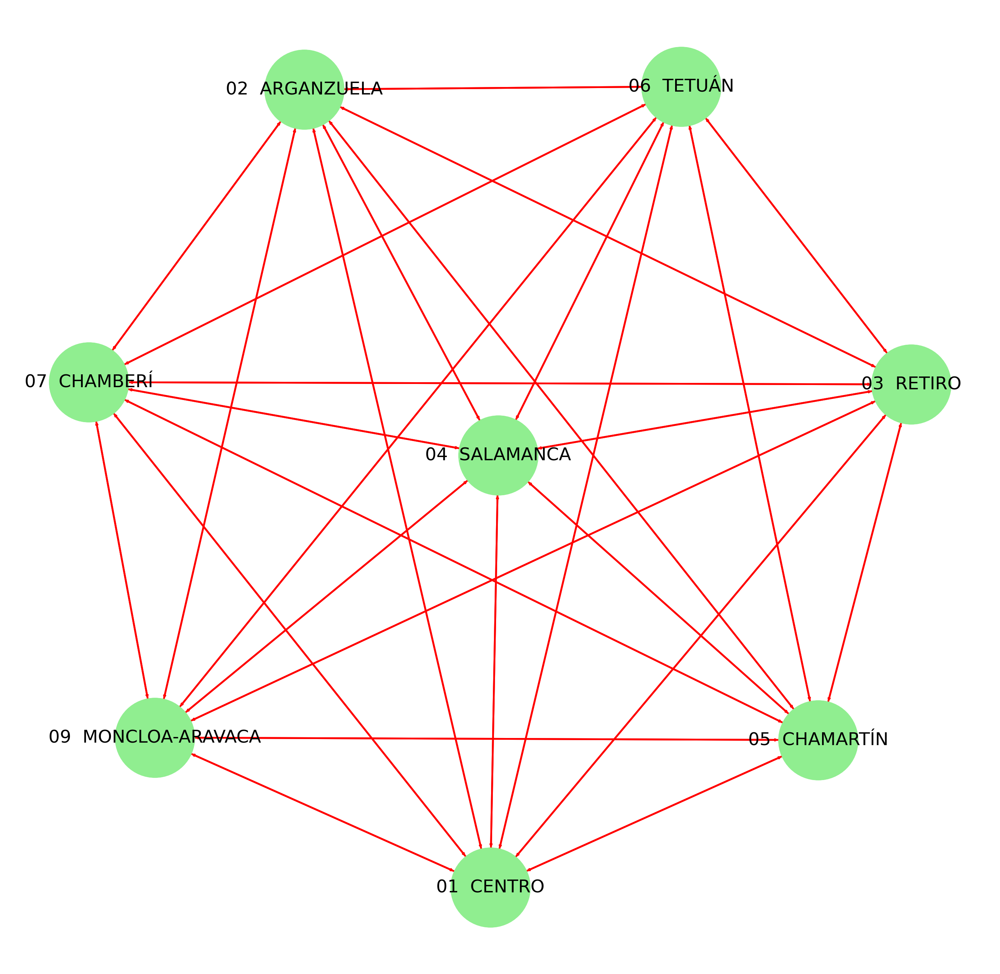

In [14]:
fig, ax = plt.subplots(1, 1, figsize=(50, 50))
nx.draw_spring(DG,
                 node_color="lightgreen",
                 edge_color="red",
                 font_size=50,
                     width=5, with_labels = True, node_size=50000,
)
ax.set_axis_off()

A peculiarity of these networks with respect to others that are made with other data, is that in these seem all the nodes connected between them. This happens because between almost all the combinations of nodes there is a certain number of bicycle trips over a year.

After that visualization, we were interested in getting a graph that showed the number of trips that went from one district to another. so we manually included all possible combinations between districts. Then we placed the number of trips as the weight of each of those connections.

In [15]:
G = nx.DiGraph() 

G.add_edges_from([("01 \xa0CENTRO", '01 \xa0CENTRO')], weight=343250) 
G.add_edges_from([('01 \xa0CENTRO', '02 \xa0ARGANZUELA')], weight=61156)
G.add_edges_from([('01 \xa0CENTRO','03 \xa0RETIRO')], weight=76520) 
G.add_edges_from([('01 \xa0CENTRO', '04 \xa0SALAMANCA')], weight=81754) 
G.add_edges_from([('01 \xa0CENTRO', '05 \xa0CHAMARTÍN')], weight=37976) 
G.add_edges_from([('01 \xa0CENTRO', '06 \xa0TETUÁN')], weight=28826) 
G.add_edges_from([('01 \xa0CENTRO', '07 \xa0CHAMBERÍ')], weight=92159) 
G.add_edges_from([('01 \xa0CENTRO', '09 \xa0MONCLOA-ARAVACA')], weight=31439) 
G.add_edges_from([('02 \xa0ARGANZUELA', '01 \xa0CENTRO')], weight=59532) 
G.add_edges_from([('02 \xa0ARGANZUELA', '02 \xa0ARGANZUELA')], weight=20464) 
G.add_edges_from([('02 \xa0ARGANZUELA', '03 \xa0RETIRO')], weight=20500) 
G.add_edges_from([('02 \xa0ARGANZUELA', '04 \xa0SALAMANCA')], weight=21879) 
G.add_edges_from([('02 \xa0ARGANZUELA', '05 \xa0CHAMARTÍN')], weight=10760) 
G.add_edges_from([('02 \xa0ARGANZUELA', '06 \xa0TETUÁN')], weight=7549) 
G.add_edges_from([('02 \xa0ARGANZUELA', '07 \xa0CHAMBERÍ')], weight=21055) 
G.add_edges_from([('02 \xa0ARGANZUELA', '09 \xa0MONCLOA-ARAVACA')], weight=7347) 
G.add_edges_from([('03 \xa0RETIRO', '01 \xa0CENTRO')], weight=74177) 
G.add_edges_from([('03 \xa0RETIRO', '02 \xa0ARGANZUELA')], weight=20226) 
G.add_edges_from([('03 \xa0RETIRO', '03 \xa0RETIRO')], weight=75013) 
G.add_edges_from([('03 \xa0RETIRO', '04 \xa0SALAMANCA')], weight=41931) 
G.add_edges_from([('03 \xa0RETIRO', '05 \xa0CHAMARTÍN')], weight=9852) 
G.add_edges_from([('03 \xa0RETIRO', '06 \xa0TETUÁN')], weight=5318) 
G.add_edges_from([('03 \xa0RETIRO', '07 \xa0CHAMBERÍ')], weight=23984) 
G.add_edges_from([('03 \xa0RETIRO', '09 \xa0MONCLOA-ARAVACA')], weight=7209) 
G.add_edges_from([('04 \xa0SALAMANCA', '01 \xa0CENTRO')], weight=83268) 
G.add_edges_from([('04 \xa0SALAMANCA', '02 \xa0ARGANZUELA')], weight=22682) 
G.add_edges_from([('04 \xa0SALAMANCA', '03 \xa0RETIRO')], weight=39105) 
G.add_edges_from([('04 \xa0SALAMANCA', '04 \xa0SALAMANCA')], weight=51207) 
G.add_edges_from([('04 \xa0SALAMANCA', '05 \xa0CHAMARTÍN')], weight=21694) 
G.add_edges_from([('04 \xa0SALAMANCA', '06 \xa0TETUÁN')], weight=12384) 
G.add_edges_from([('04 \xa0SALAMANCA', '07 \xa0CHAMBERÍ')], weight=31010) 
G.add_edges_from([('04 \xa0SALAMANCA', '09 \xa0MONCLOA-ARAVACA')], weight=10888) 
G.add_edges_from([('05 \xa0CHAMARTÍN', '01 \xa0CENTRO')], weight=39994)
G.add_edges_from([('05 \xa0CHAMARTÍN', '02 \xa0ARGANZUELA')], weight=9763)
G.add_edges_from([('05 \xa0CHAMARTÍN', '03 \xa0RETIRO')], weight=21313)
G.add_edges_from([('05 \xa0CHAMARTÍN', '04 \xa0SALAMANCA')], weight=26365)
G.add_edges_from([('05 \xa0CHAMARTÍN', '05 \xa0CHAMARTÍN')], weight=10938)
G.add_edges_from([('05 \xa0CHAMARTÍN', '06 \xa0TETUÁN')], weight=18487)
G.add_edges_from([('05 \xa0CHAMARTÍN', '07 \xa0CHAMBERÍ')], weight=7440)
G.add_edges_from([('05 \xa0CHAMARTÍN', '09 \xa0MONCLOA-ARAVACA')], weight=28309)
G.add_edges_from([('06 \xa0TETUÁN', '01 \xa0CENTRO')], weight=7000)
G.add_edges_from([('06 \xa0TETUÁN', '02 \xa0ARGANZUELA')], weight=5669)
G.add_edges_from([('06 \xa0TETUÁN', '03 \xa0RETIRO')], weight=11671)
G.add_edges_from([('06 \xa0TETUÁN', '04 \xa0SALAMANCA')], weight=11438)
G.add_edges_from([('06 \xa0TETUÁN', '05 \xa0CHAMARTÍN')], weight=9872)
G.add_edges_from([('06 \xa0TETUÁN', '06 \xa0TETUÁN')], weight=13579)
G.add_edges_from([('06 \xa0TETUÁN', '07 \xa0CHAMBERÍ')], weight=4627)
G.add_edges_from([('06 \xa0TETUÁN', '09 \xa0MONCLOA-ARAVACA')], weight=92803)
G.add_edges_from([('07 \xa0CHAMBERÍ', '01 \xa0CENTRO')], weight=20305)
G.add_edges_from([('07 \xa0CHAMBERÍ', '02 \xa0ARGANZUELA')], weight=24798)
G.add_edges_from([('07 \xa0CHAMBERÍ', '03 \xa0RETIRO')], weight=31965)
G.add_edges_from([('07 \xa0CHAMBERÍ', '04 \xa0SALAMANCA')], weight=18307)
G.add_edges_from([('07 \xa0CHAMBERÍ', '05 \xa0CHAMARTÍN')], weight=13025)
G.add_edges_from([('07 \xa0CHAMBERÍ', '06 \xa0TETUÁN')], weight=49403)
G.add_edges_from([('07 \xa0CHAMBERÍ', '07 \xa0CHAMBERÍ')], weight=9998)
G.add_edges_from([('07 \xa0CHAMBERÍ', '09 \xa0MONCLOA-ARAVACA')], weight=32102)


The result is as follows. In this case, the connections between districts are also displayed, but in addition the number of paths that exist in each connection is shown on each edge.

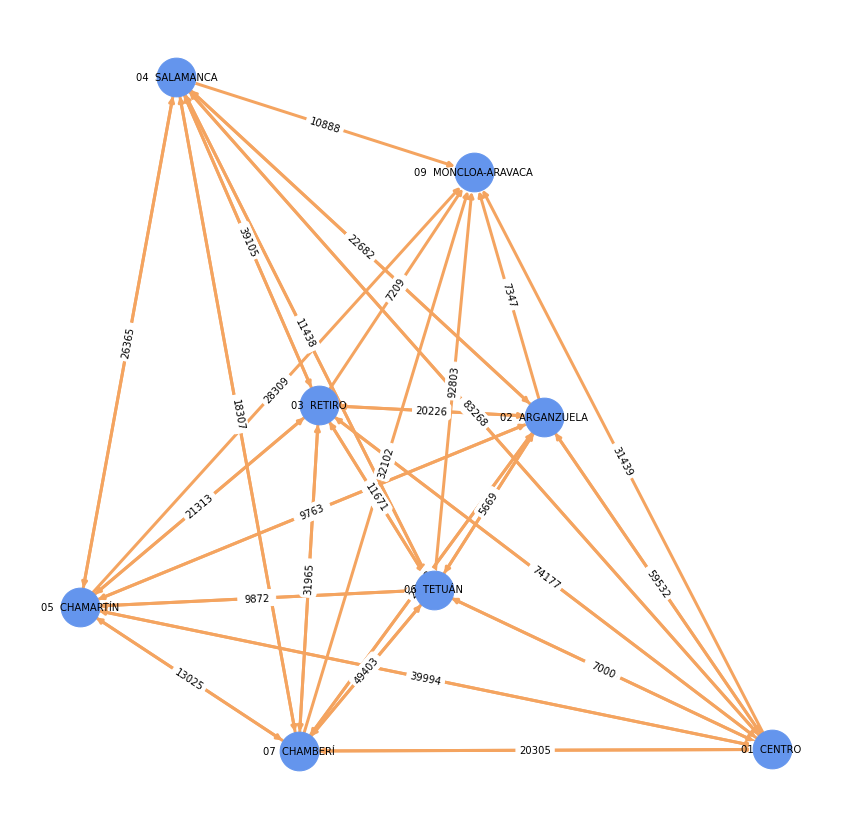

In [16]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue") 

# Graph of each of the Districts

Finally, we want to represent the trips from each district.

###  <font color='blue'>CENTRO</font> 

In [17]:
G = nx.DiGraph() 

G.add_edges_from([("01 \xa0CENTRO", '01 \xa0CENTRO')], weight=343250) 
G.add_edges_from([('01 \xa0CENTRO', '02 \xa0ARGANZUELA')], weight=61156)
G.add_edges_from([('01 \xa0CENTRO','03 \xa0RETIRO')], weight=76520) 
G.add_edges_from([('01 \xa0CENTRO', '04 \xa0SALAMANCA')], weight=81754) 
G.add_edges_from([('01 \xa0CENTRO', '05 \xa0CHAMARTÍN')], weight=37976) 
G.add_edges_from([('01 \xa0CENTRO', '06 \xa0TETUÁN')], weight=28826) 
G.add_edges_from([('01 \xa0CENTRO', '07 \xa0CHAMBERÍ')], weight=92159) 
G.add_edges_from([('01 \xa0CENTRO', '09 \xa0MONCLOA-ARAVACA')], weight=31439) 

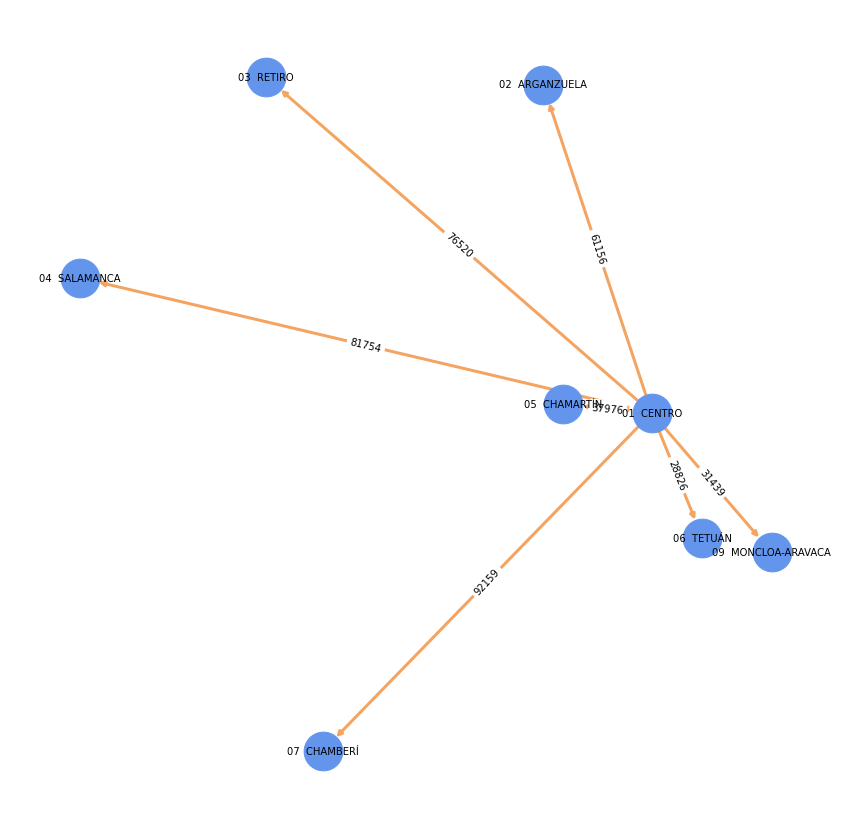

In [18]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>ARGANZUELA</font> 

In [19]:
G = nx.DiGraph() 

G.add_edges_from([('02 \xa0ARGANZUELA', '01 \xa0CENTRO')], weight=59532) 
G.add_edges_from([('02 \xa0ARGANZUELA', '02 \xa0ARGANZUELA')], weight=20464) 
G.add_edges_from([('02 \xa0ARGANZUELA', '03 \xa0RETIRO')], weight=20500) 
G.add_edges_from([('02 \xa0ARGANZUELA', '04 \xa0SALAMANCA')], weight=21879) 
G.add_edges_from([('02 \xa0ARGANZUELA', '05 \xa0CHAMARTÍN')], weight=10760) 
G.add_edges_from([('02 \xa0ARGANZUELA', '06 \xa0TETUÁN')], weight=7549) 
G.add_edges_from([('02 \xa0ARGANZUELA', '07 \xa0CHAMBERÍ')], weight=21055) 
G.add_edges_from([('02 \xa0ARGANZUELA', '09 \xa0MONCLOA-ARAVACA')], weight=7347) 

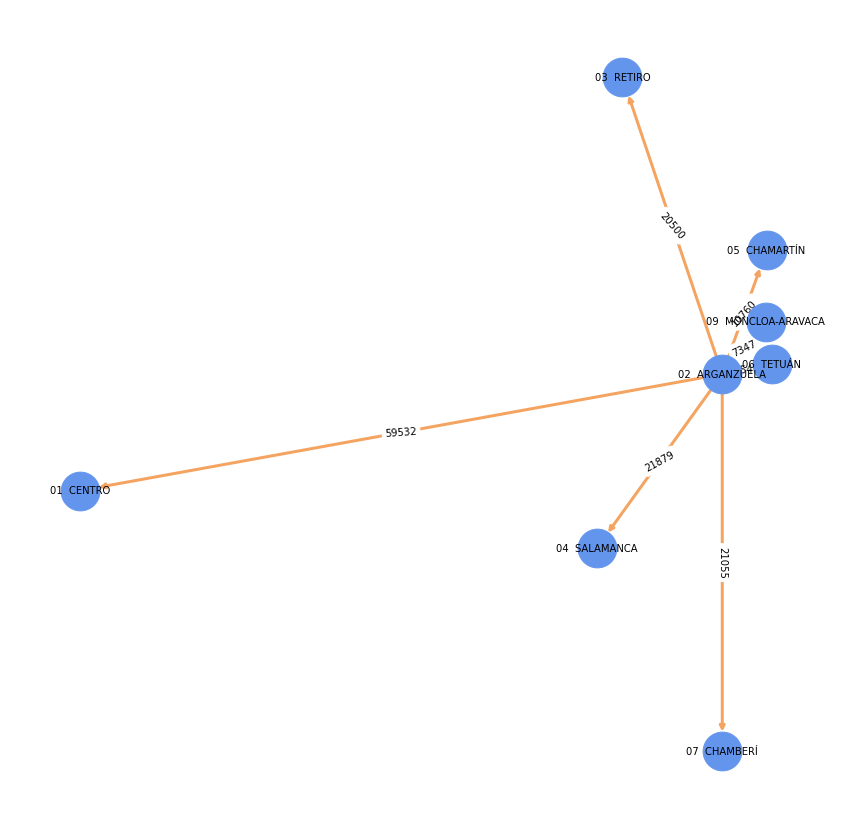

In [20]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>RETIRO</font> 

In [21]:
G = nx.DiGraph() 

G.add_edges_from([('03 \xa0RETIRO', '01 \xa0CENTRO')], weight=74177) 
G.add_edges_from([('03 \xa0RETIRO', '02 \xa0ARGANZUELA')], weight=20226) 
G.add_edges_from([('03 \xa0RETIRO', '03 \xa0RETIRO')], weight=75013) 
G.add_edges_from([('03 \xa0RETIRO', '04 \xa0SALAMANCA')], weight=41931) 
G.add_edges_from([('03 \xa0RETIRO', '05 \xa0CHAMARTÍN')], weight=9852) 
G.add_edges_from([('03 \xa0RETIRO', '06 \xa0TETUÁN')], weight=5318) 
G.add_edges_from([('03 \xa0RETIRO', '07 \xa0CHAMBERÍ')], weight=23984) 
G.add_edges_from([('03 \xa0RETIRO', '09 \xa0MONCLOA-ARAVACA')], weight=7209) 

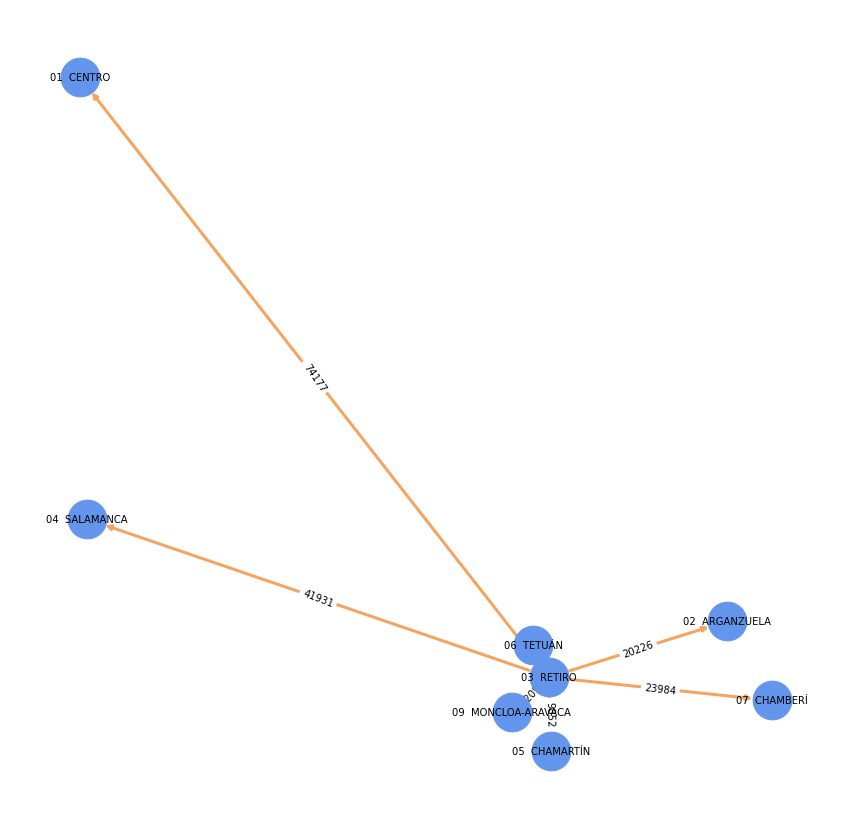

In [22]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>SALAMANCA</font> 

In [23]:

G = nx.DiGraph() 
G.add_edges_from([('04 \xa0SALAMANCA', '01 \xa0CENTRO')], weight=83268) 
G.add_edges_from([('04 \xa0SALAMANCA', '02 \xa0ARGANZUELA')], weight=22682) 
G.add_edges_from([('04 \xa0SALAMANCA', '03 \xa0RETIRO')], weight=39105) 
G.add_edges_from([('04 \xa0SALAMANCA', '04 \xa0SALAMANCA')], weight=51207) 
G.add_edges_from([('04 \xa0SALAMANCA', '05 \xa0CHAMARTÍN')], weight=21694) 
G.add_edges_from([('04 \xa0SALAMANCA', '06 \xa0TETUÁN')], weight=12384) 
G.add_edges_from([('04 \xa0SALAMANCA', '07 \xa0CHAMBERÍ')], weight=31010) 
G.add_edges_from([('04 \xa0SALAMANCA', '09 \xa0MONCLOA-ARAVACA')], weight=10888) 

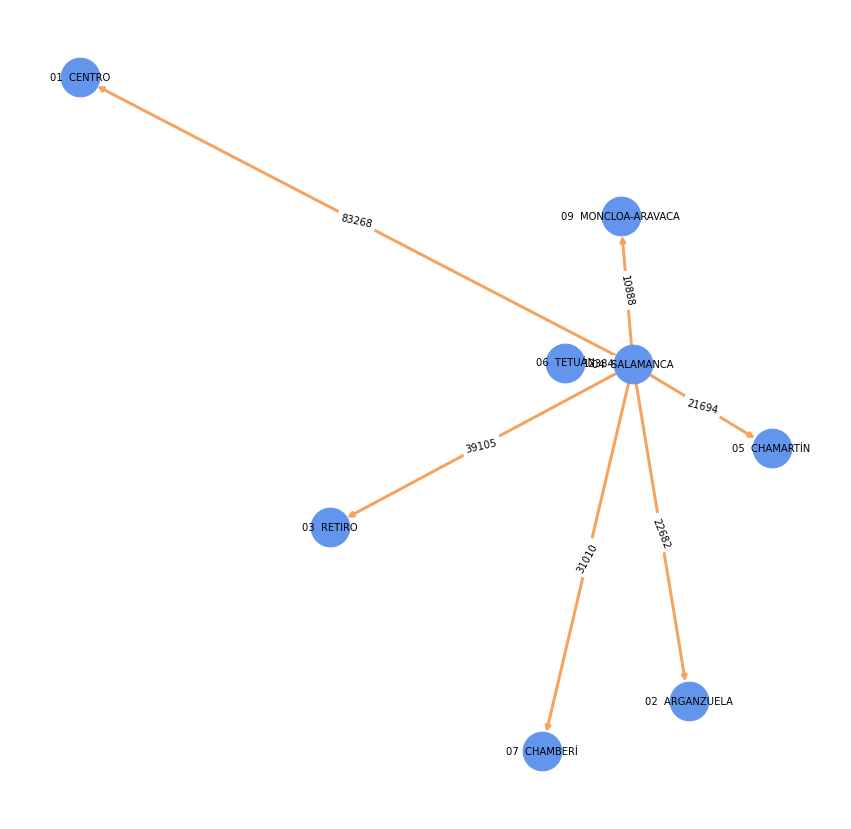

In [24]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>CHAMARTÍN</font> 

In [25]:

G = nx.DiGraph() 
G.add_edges_from([('05 \xa0CHAMARTÍN', '01 \xa0CENTRO')], weight=39994)
G.add_edges_from([('05 \xa0CHAMARTÍN', '02 \xa0ARGANZUELA')], weight=9763)
G.add_edges_from([('05 \xa0CHAMARTÍN', '03 \xa0RETIRO')], weight=21313)
G.add_edges_from([('05 \xa0CHAMARTÍN', '04 \xa0SALAMANCA')], weight=26365)
G.add_edges_from([('05 \xa0CHAMARTÍN', '05 \xa0CHAMARTÍN')], weight=10938)
G.add_edges_from([('05 \xa0CHAMARTÍN', '06 \xa0TETUÁN')], weight=18487)
G.add_edges_from([('05 \xa0CHAMARTÍN', '07 \xa0CHAMBERÍ')], weight=7440)
G.add_edges_from([('05 \xa0CHAMARTÍN', '09 \xa0MONCLOA-ARAVACA')], weight=28309)

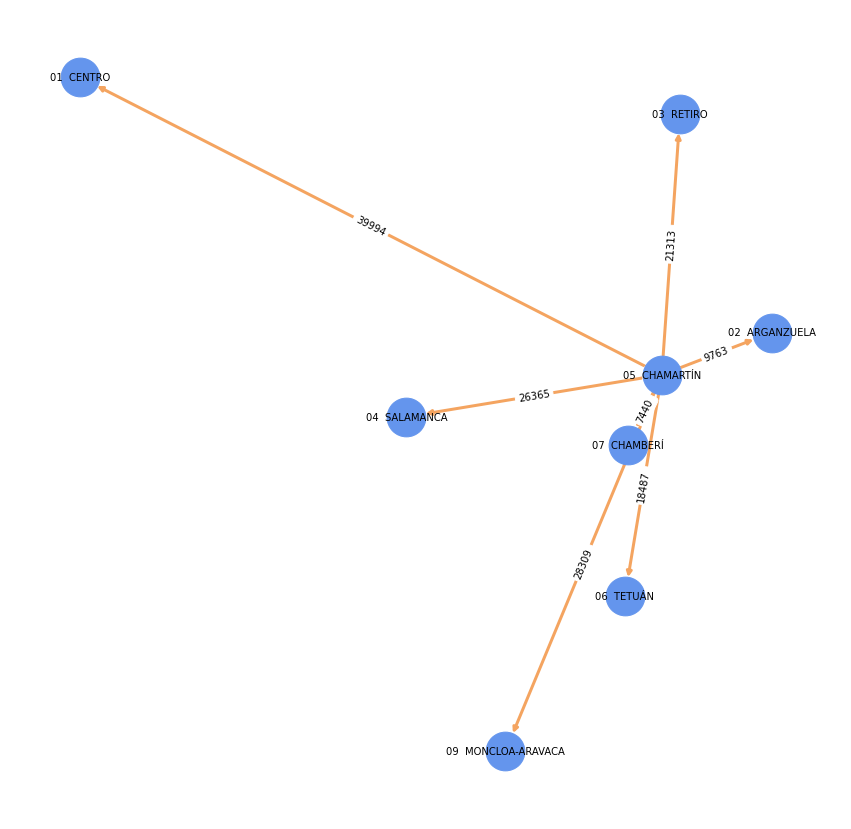

In [26]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>TETUÁN</font> 

In [27]:

G = nx.DiGraph() 
G.add_edges_from([('06 \xa0TETUÁN', '01 \xa0CENTRO')], weight=7000)
G.add_edges_from([('06 \xa0TETUÁN', '02 \xa0ARGANZUELA')], weight=5669)
G.add_edges_from([('06 \xa0TETUÁN', '03 \xa0RETIRO')], weight=11671)
G.add_edges_from([('06 \xa0TETUÁN', '04 \xa0SALAMANCA')], weight=11438)
G.add_edges_from([('06 \xa0TETUÁN', '05 \xa0CHAMARTÍN')], weight=9872)
G.add_edges_from([('06 \xa0TETUÁN', '06 \xa0TETUÁN')], weight=13579)
G.add_edges_from([('06 \xa0TETUÁN', '07 \xa0CHAMBERÍ')], weight=4627)
G.add_edges_from([('06 \xa0TETUÁN', '09 \xa0MONCLOA-ARAVACA')], weight=92803)

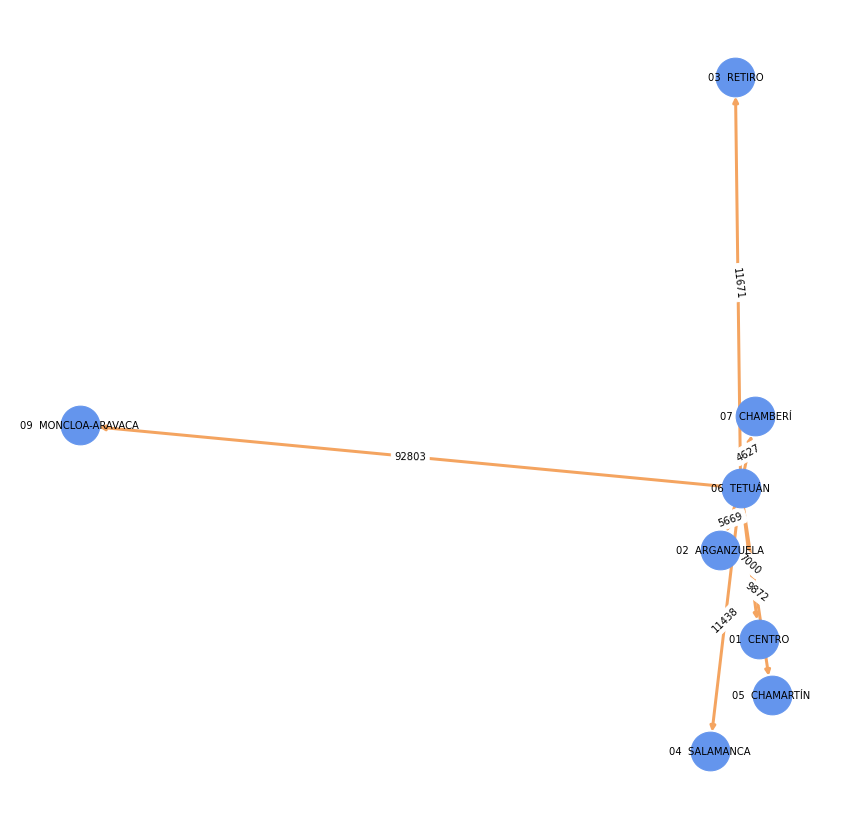

In [28]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>CHAMBERÍ</font> 

In [29]:

G = nx.DiGraph() 
G.add_edges_from([('07 \xa0CHAMBERÍ', '01 \xa0CENTRO')], weight=20305)
G.add_edges_from([('07 \xa0CHAMBERÍ', '02 \xa0ARGANZUELA')], weight=24798)
G.add_edges_from([('07 \xa0CHAMBERÍ', '03 \xa0RETIRO')], weight=31965)
G.add_edges_from([('07 \xa0CHAMBERÍ', '04 \xa0SALAMANCA')], weight=18307)
G.add_edges_from([('07 \xa0CHAMBERÍ', '05 \xa0CHAMARTÍN')], weight=13025)
G.add_edges_from([('07 \xa0CHAMBERÍ', '06 \xa0TETUÁN')], weight=49403)
G.add_edges_from([('07 \xa0CHAMBERÍ', '07 \xa0CHAMBERÍ')], weight=9998)
G.add_edges_from([('07 \xa0CHAMBERÍ', '09 \xa0MONCLOA-ARAVACA')], weight=32102)

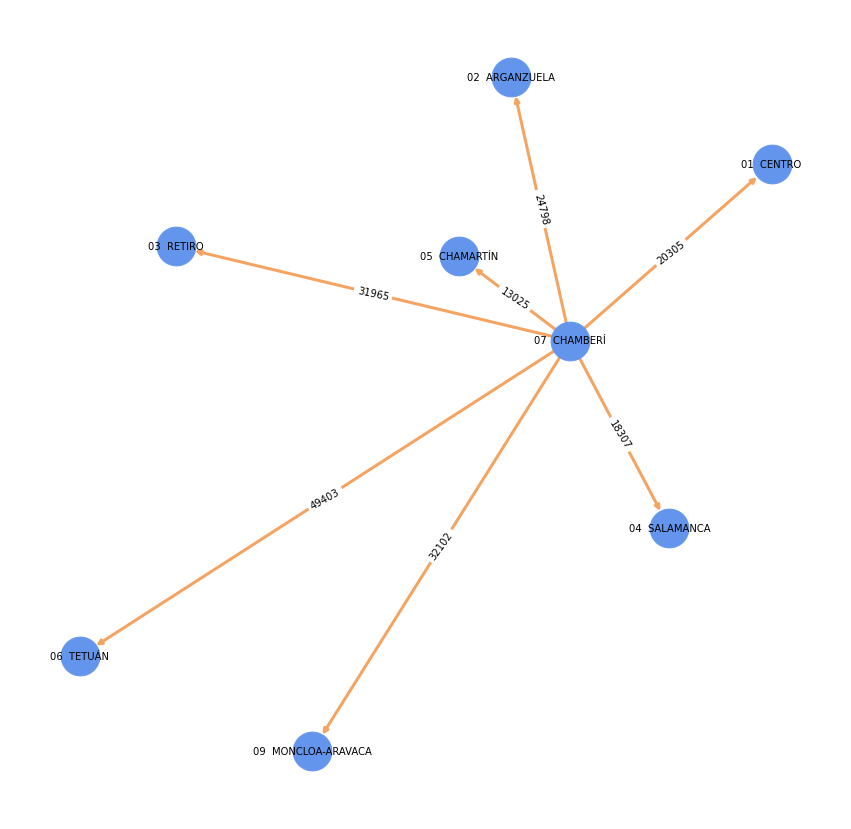

In [30]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")

###  <font color='blue'>MONCLOA-ARAVACAÍ</font> 

In [31]:

G = nx.DiGraph() 
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '01 \xa0CENTRO')], weight=7566)
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '02 \xa0ARGANZUELA')], weight=7276)
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '03 \xa0RETIRO')], weight=10685)
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '04 \xa0SALAMANCA')], weight=6769)
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '05 \xa0CHAMARTÍN')], weight=4440)
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '06 \xa0TETUÁN')], weight=10104)
G.add_edges_from([('09 \xa0MONCLOA-ARAVACAÍ', '07 \xa0CHAMBERÍ')], weight=10357)


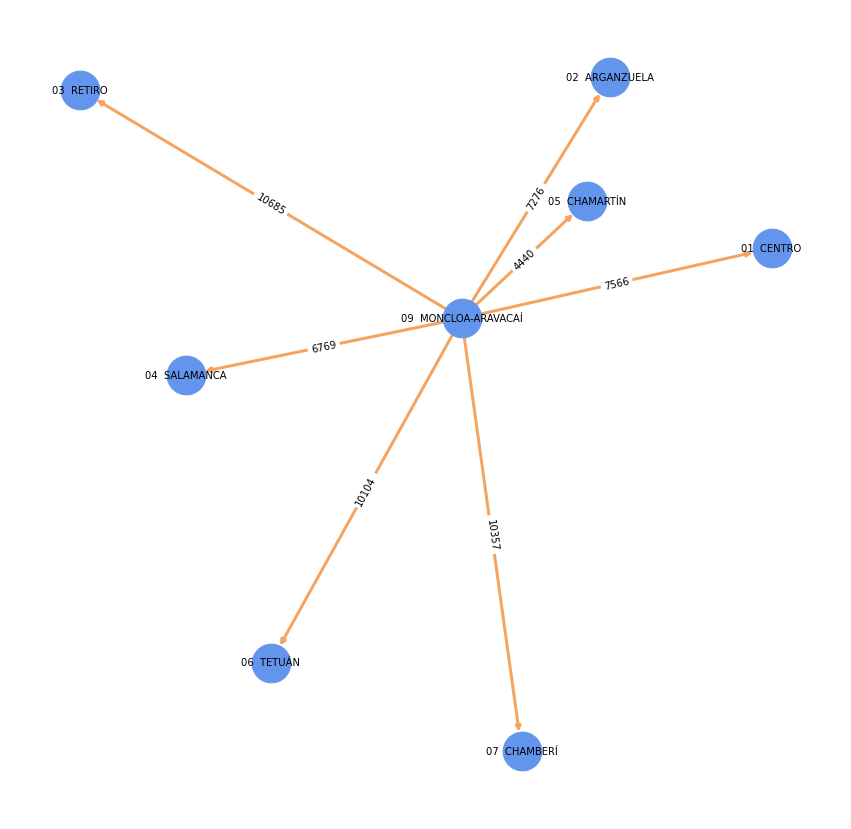

In [32]:
edge_labels=dict([((u,v,),d['weight']) 
       for u,v,d in G.edges(data=True)]) 

fig, ax = plt.subplots(1, 1, figsize=(15, 15))
pos=nx.kamada_kawai_layout(G) 
nx.draw_networkx_edge_labels(G,pos,edge_labels=edge_labels) 
nx.draw(G,pos, node_size=1500, with_labels = True, width= 3, font_size = 10, edge_color= "sandybrown", node_color = "cornflowerblue")